In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("shravankumar9892/image-colorization")

print("Path to dataset files:", path)

100%|██████████| 2.10G/2.10G [00:25<00:00, 87.3MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4


In [ ]:
!pip install torchsummary

In [ ]:
!pip install pytorch-lightning

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 20.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 38.5 MB/s eta 0:00:00


In [ ]:
import os
from pathlib import Path

# Import glob to get the files directories recursively
import glob

# Import Garbage collector interface
import gc

# Import OpenCV to transforme pictures
import cv2

# Import Time
import time

# Import math
import math

# import numpy for math calculations
import numpy as np

# Import pandas for data (csv) manipulation
import pandas as pd

# Import matplotlib for plotting
import matplotlib.pyplot as plt
import matplotlib
matplotlib.style.use('fivethirtyeight')
%matplotlib inline

import PIL
from PIL import Image
from skimage.color import rgb2lab, lab2rgb

import pytorch_lightning as pl

# Import pytorch to build Deel Learling Models
import torch
from torch import nn, optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable
from torchvision import models
from torch.nn import functional as F
import torch.utils.data
from torchvision.models.inception import inception_v3
from scipy.stats import entropy

from torchsummary import summary

# Import tqdm to show a smart progress meter
from tqdm import tqdm

# Import warnings to hide the unnessairy warniings
import warnings
warnings.filterwarnings('ignore')

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# path 변수에 저장된 디렉토리 내 파일 목록 출력
print("Dataset contents:")
for root, dirs, files in os.walk(path):
    for file in files:
        print(os.path.join(root, file))

Dataset contents:
/root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4/inception_resnet_v2_weights_tf_dim_ordering_tf_kernels.h5
/root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4/l/gray_scale.npy
/root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4/ab/ab/ab2.npy
/root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4/ab/ab/ab3.npy
/root/.cache/kagglehub/datasets/shravankumar9892/image-colorization/versions/4/ab/ab/ab1.npy


In [ ]:
# npy 파일 열기
gray_scale_path = f"{path}/l/gray_scale.npy"
ab1_path = f"{path}/ab/ab/ab1.npy"

# 데이터를 로드
L_df = (np.load(gray_scale_path))[:1000]
ab1_df = (np.load(ab1_path))[:1000]

# 데이터 확인
print("Gray Scale Shape:", L_df.shape) # (h, w) 형식
print("AB1 Shape:", ab1_df.shape) # (h, w, 2) 형식

Gray Scale Shape: (1000, 224, 224)
AB1 Shape: (1000, 224, 224, 2)


In [ ]:
print("AB1 min:", ab1_df.min(), "max:", ab1_df.max())

AB1 min: 20 max: 224


In [ ]:
L_df.min(), L_df.max()

(0, 255)

In [ ]:
dataset = (L_df, ab1_df)
gc.collect()

11

In [ ]:
def lab_to_rgb(L, ab):
    """
    Takes an image or a batch of images and converts from LAB space to RGB
    """
    L = L  * 100
    ab = (ab - 0.5) * 128 * 2
    Lab = torch.cat([L, ab], dim=2).numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

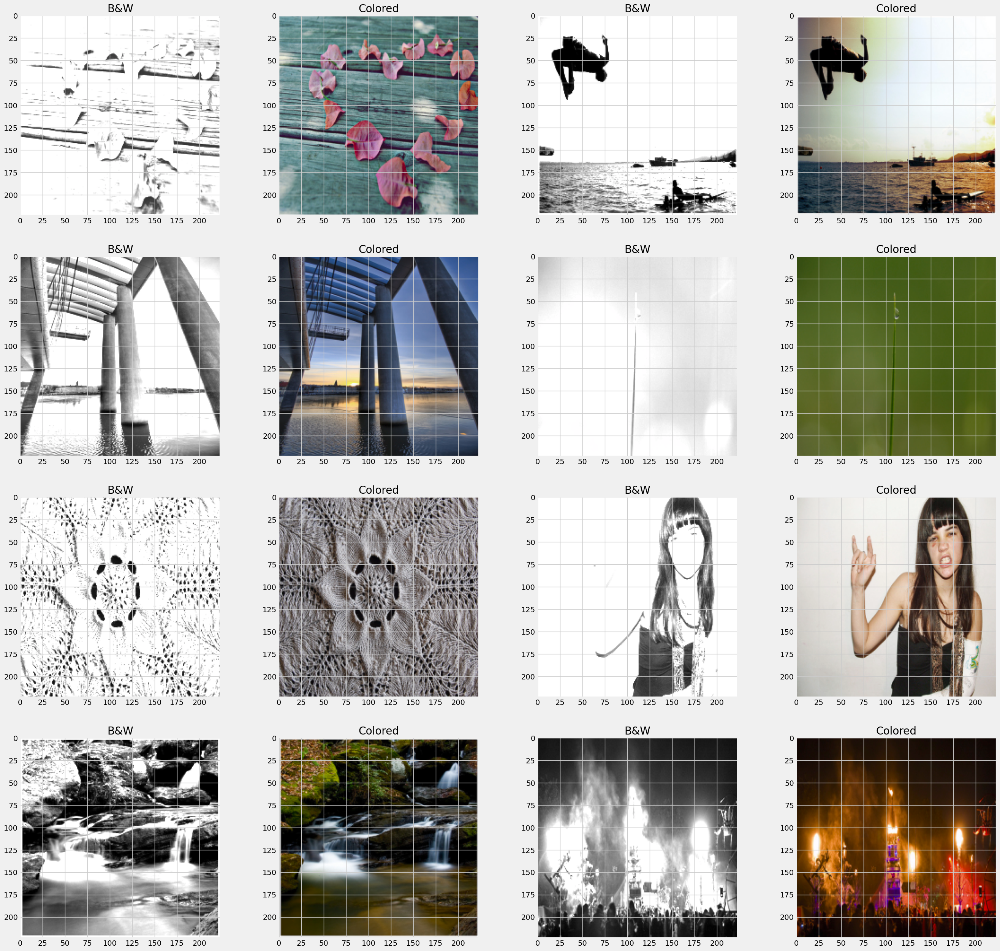

In [ ]:
plt.figure(figsize=(30,30))
for i in range(1,16,2):
    plt.subplot(4,4,i)
    img = np.zeros((224,224,3))
    img[:,:,0] = L_df[i]
    plt.title('B&W')
    plt.imshow(lab2rgb(img))

    plt.subplot(4,4,i+1)
    img[:,:,1:] = ab1_df[i]
    img = img.astype('uint8')
    img = cv2.cvtColor(img, cv2.COLOR_LAB2RGB)
    plt.title('Colored')
    plt.imshow(img)

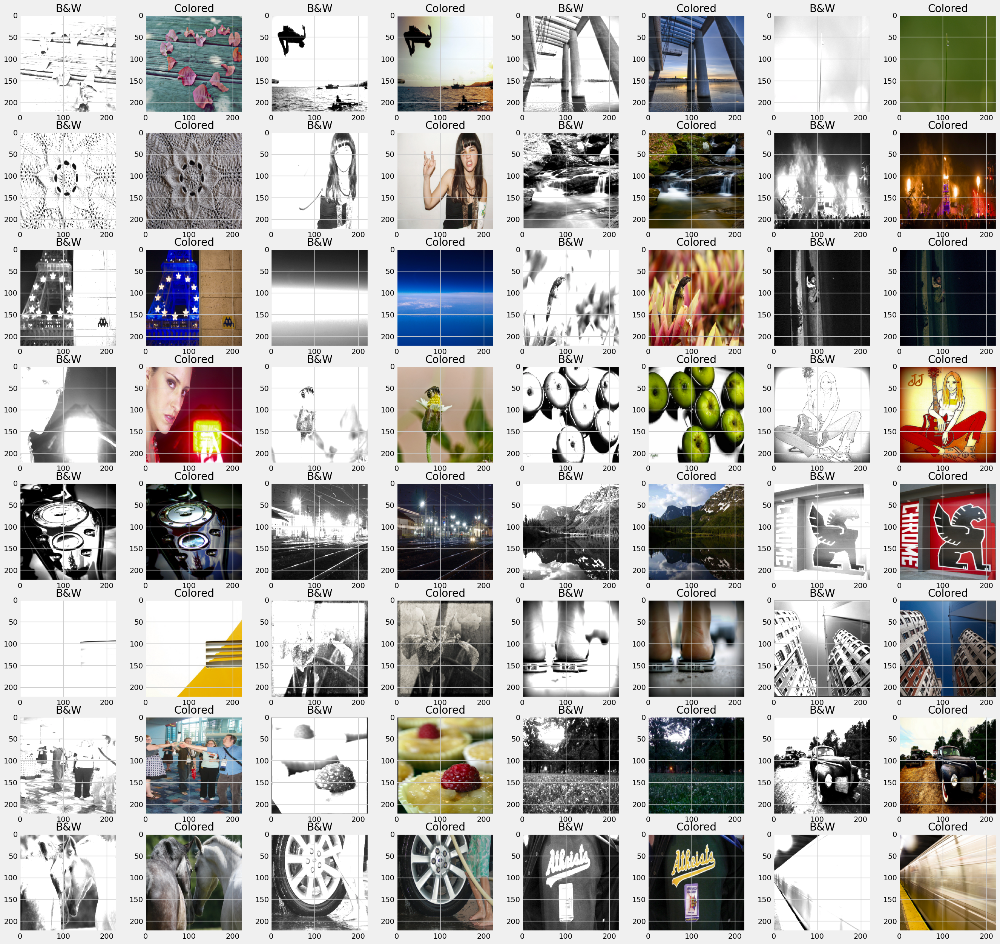

In [ ]:
plt.figure(figsize=(30,30))
for i in range(1,65,2):
    plt.subplot(8,8,i)
    img = np.zeros((224,224,3))
    img[:,:,0] = L_df[i]
    plt.title('B&W')
    plt.imshow(lab2rgb(img))

    plt.subplot(8,8,i+1)
    img[:,:,1:] = ab1_df[i]
    img = img.astype('uint8')
    img = cv2.cvtColor(img, cv2.COLOR_LAB2RGB)
    plt.title('Colored')
    plt.imshow(img)

In [ ]:
gc.collect()

175009

## Data Loader

In [ ]:
class ImageColorizationDataset(Dataset):
    ''' Black and White (L) Images and corresponding A&B Colors'''
    def __init__(self, dataset, transform=None):
        '''
        :param dataset: Dataset name.
        :param data_dir: Directory with all the images.
        :param transform: Optional transform to be applied on sample
        '''
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset[0])

    def __getitem__(self, idx):
        L = np.array(dataset[0][idx]).reshape((224,224,1))
        L = transforms.ToTensor()(L)

        ab = np.array(dataset[1][idx])
        ab = transforms.ToTensor()(ab)

        return ab, L

In [ ]:
batch_size = 1

# Prepare the Datasets
train_dataset = ImageColorizationDataset(dataset = (L_df, ab1_df))
test_dataset = ImageColorizationDataset(dataset = (L_df, ab1_df))

# Build DataLoaders
train_loader = DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle = True, pin_memory = True)
test_loader = DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle = False, pin_memory = True)

In [ ]:
class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.layer = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,kernel_size=3, padding=1, stride=stride, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels,kernel_size=3,padding=1, stride=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

        self.identity_map = nn.Conv2d(in_channels, out_channels,kernel_size=1,stride=stride)
        self.relu = nn.ReLU(inplace=True)
    def forward(self, inputs):
        x = inputs.clone().detach()
        out = self.layer(x)
        residual  = self.identity_map(inputs)
        skip = out + residual
        return self.relu(skip)

In [ ]:
class DownSampleConv(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super().__init__()
        self.layer = nn.Sequential(
            nn.MaxPool2d(2),
            ResBlock(in_channels, out_channels)
        )

    def forward(self, inputs):
        return self.layer(inputs)

In [ ]:
class UpSampleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.upsample = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.res_block = ResBlock(in_channels + out_channels, out_channels)

    def forward(self, inputs, skip):
        x = self.upsample(inputs)
        x = torch.cat([x, skip], dim=1)
        x = self.res_block(x)
        return x

In [ ]:
class Generator(nn.Module):
    def __init__(self, input_channel, output_channel, dropout_rate = 0.2):
        super().__init__()
        self.encoding_layer1_ = ResBlock(input_channel,64)
        self.encoding_layer2_ = DownSampleConv(64, 128)
        self.encoding_layer3_ = DownSampleConv(128, 256)
        self.bridge = DownSampleConv(256, 512)
        self.decoding_layer3_ = UpSampleConv(512, 256)
        self.decoding_layer2_ = UpSampleConv(256, 128)
        self.decoding_layer1_ = UpSampleConv(128, 64)
        self.output = nn.Conv2d(64, output_channel, kernel_size=1)
        self.dropout = nn.Dropout2d(dropout_rate)

    def forward(self, inputs):
        ###################### Enocoder #########################
        e1 = self.encoding_layer1_(inputs)
        e1 = self.dropout(e1)
        e2 = self.encoding_layer2_(e1)
        e2 = self.dropout(e2)
        e3 = self.encoding_layer3_(e2)
        e3 = self.dropout(e3)

        ###################### Bridge #########################
        bridge = self.bridge(e3)
        bridge = self.dropout(bridge)

        ###################### Decoder #########################
        d3 = self.decoding_layer3_(bridge, e3)
        d2 = self.decoding_layer2_(d3, e2)
        d1 = self.decoding_layer1_(d2, e1)

        ###################### Output #########################
        output = self.output(d1)
        return output

In [ ]:
model = Generator(1,2).to(device)
summary(model, (1, 224, 224), batch_size = 1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 64, 224, 224]             576
       BatchNorm2d-2          [1, 64, 224, 224]             128
              ReLU-3          [1, 64, 224, 224]               0
            Conv2d-4          [1, 64, 224, 224]          36,864
       BatchNorm2d-5          [1, 64, 224, 224]             128
              ReLU-6          [1, 64, 224, 224]               0
            Conv2d-7          [1, 64, 224, 224]             128
              ReLU-8          [1, 64, 224, 224]               0
          ResBlock-9          [1, 64, 224, 224]               0
        Dropout2d-10          [1, 64, 224, 224]               0
        MaxPool2d-11          [1, 64, 112, 112]               0
           Conv2d-12         [1, 128, 112, 112]          73,728
      BatchNorm2d-13         [1, 128, 112, 112]             256
             ReLU-14         [1, 128, 1

In [ ]:
class Critic(nn.Module):
    def __init__(self, in_channels=3):
        super(Critic, self).__init__()

        def critic_block(in_filters, out_filters, normalization=True):
            """Returns layers of each critic block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *critic_block(in_channels, 64, normalization=False),
            *critic_block(64, 128),
            *critic_block(128, 256),
            *critic_block(256, 512),
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(512, 1)
        )

    def forward(self, ab, l):
        # Concatenate image and condition image by channels to produce input
        img_input = torch.cat((ab, l), 1)
        output = self.model(img_input)
        return output

In [ ]:
model = Critic(3).to(device)
summary(model, [(2, 224, 224), (1, 224, 224)], batch_size = 1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 64, 112, 112]           3,136
         LeakyReLU-2          [1, 64, 112, 112]               0
            Conv2d-3           [1, 128, 56, 56]         131,200
    InstanceNorm2d-4           [1, 128, 56, 56]               0
         LeakyReLU-5           [1, 128, 56, 56]               0
            Conv2d-6           [1, 256, 28, 28]         524,544
    InstanceNorm2d-7           [1, 256, 28, 28]               0
         LeakyReLU-8           [1, 256, 28, 28]               0
            Conv2d-9           [1, 512, 14, 14]       2,097,664
   InstanceNorm2d-10           [1, 512, 14, 14]               0
        LeakyReLU-11           [1, 512, 14, 14]               0
AdaptiveAvgPool2d-12             [1, 512, 1, 1]               0
          Flatten-13                   [1, 512]               0
           Linear-14                   

In [ ]:
# https://stackoverflow.com/questions/49433936/how-to-initialize-weights-in-pytorch
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [ ]:
def display_progress(cond, real, fake, current_epoch = 0, figsize=(20,15)):
    """
    Save cond, real (original) and generated (fake)
    images in one panel
    """
    cond = cond.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)

    images = [cond, real, fake]
    titles = ['input','real','generated']
    print(f'Epoch: {current_epoch}')
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    for idx,img in enumerate(images):
        if idx == 0:
            ab = torch.zeros((224,224,2))
            img = torch.cat([images[0]* 100, ab], dim=2).numpy()
            imgan = lab2rgb(img)
        else:
            imgan = lab_to_rgb(images[0],img)
        ax[idx].imshow(imgan)
        ax[idx].axis("off")
    for idx, title in enumerate(titles):
        ax[idx].set_title('{}'.format(title))
    plt.show()

In [ ]:
class CWGAN(pl.LightningModule):
    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_recon=100, display_step=10, lambda_gp=10, lambda_r1=10):
        super().__init__()
        self.automatic_optimization = False
        self.save_hyperparameters()

        # Generator와 Critic 초기화
        self.generator = Generator(in_channels, out_channels)
        self.critic = Critic(in_channels + out_channels)

        # Optimizer 초기화
        self.optimizer_G = optim.Adam(self.generator.parameters(), lr=learning_rate, betas=(0.5, 0.9))
        self.optimizer_C = optim.Adam(self.critic.parameters(), lr=learning_rate, betas=(0.5, 0.9))

        # 손실 함수 및 하이퍼파라미터
        self.lambda_recon = lambda_recon
        self.lambda_gp = lambda_gp
        self.lambda_r1 = lambda_r1
        self.recon_criterion = nn.L1Loss()
        self.generator_losses, self.critic_losses = [], []
        self.display_step = display_step

        # VGG 초기화 (Perceptual Loss)
        self.vgg = models.vgg16(pretrained=True).features[:16].eval()
        for param in self.vgg.parameters():
            param.requires_grad = False

    def configure_optimizers(self):
        return [self.optimizer_C, self.optimizer_G]

    def perceptual_loss(self, fake_images, real_images):
        """Compute Perceptual Loss using VGG."""
        # 2채널 또는 1채널 이미지를 3채널로 변환
        if fake_images.size(1) == 1 or fake_images.size(1) == 2:
            fake_images = fake_images.repeat(1, 3, 1, 1)  # (B, C, H, W) -> (B, 3, H, W)
        if real_images.size(1) == 1 or real_images.size(1) == 2:
            real_images = real_images.repeat(1, 3, 1, 1)

        # 이미지 크기 리사이징 (224x224)
        fake_resized = F.interpolate(fake_images, size=(224, 224), mode="bilinear", align_corners=False)
        real_resized = F.interpolate(real_images, size=(224, 224), mode="bilinear", align_corners=False)

        # 6채널 데이터를 3채널로 변환
        if fake_resized.size(1) == 6:
            fake_resized = fake_resized[:, :3, :, :]  # 첫 3채널만 사용
        if real_resized.size(1) == 6:
            real_resized = real_resized[:, :3, :, :]  # 첫 3채널만 사용

        # print(fake_resized.shape)
        # print(real_resized.shape)

        # VGG 특성 추출
        fake_features = self.vgg(fake_resized)
        real_features = self.vgg(real_resized)

        # Perceptual Loss 계산
        return F.mse_loss(fake_features, real_features)

    def color_loss(self, fake_images, real_images):
        """Compute Color Loss in LAB color space."""
        # print(fake_images.shape) # torch.Size([1, 2, 224, 224])

        # 텐서의 차원을 (B, H, W, C) 순서로 변경
        fake_np = fake_images.detach().cpu().numpy().transpose(0, 2, 3, 1)
        real_np = real_images.detach().cpu().numpy().transpose(0, 2, 3, 1)

        L = np.full_like(real_np[..., 0], 50)  # 224, 224 크기
        L = np.expand_dims(L, axis=-1)
        # print(L.shape) # (1, 224, 224, 1)

        # rgb2lab에 넣기 위해 [0,1]사이로 정규화
        fake_np = np.clip(fake_np, 0, 1)

        # print(fake_np.shape) # (1, 224, 224, 2)

        # print(fake_np.min(), fake_np.max()) # 0.0 1.0

        fake_np_cat = np.concatenate([L, fake_np[..., 0:1], fake_np[..., 1:2]], axis=-1)  # (1, 224, 224, 3)
        # print(fake_np_cat.shape)
        fake_lab = lab2rgb(fake_np_cat)
        # print(fake_lab.shape)

        fake_ab = torch.tensor(fake_lab[..., 1:], dtype=torch.float32).to(fake_images.device)
        real_ab = torch.tensor(real_np[..., 1:], dtype=torch.float32).to(real_images.device)

        return F.l1_loss(fake_ab, real_ab)

    def generator_step(self, real_images, conditioned_images):
        self.optimizer_G.zero_grad()

        fake_images = self.generator(conditioned_images)

        # Losses
        recon_loss = self.recon_criterion(fake_images, real_images)
        perc_loss = self.perceptual_loss(fake_images, real_images)
        color_loss = self.color_loss(fake_images, real_images)

        # Total Generator Loss
        gen_loss = recon_loss + 0.005 * perc_loss + 0.1 * color_loss
        gen_loss.backward()
        self.optimizer_G.step()

        self.generator_losses.append(gen_loss.item())

    def critic_step(self, real_images, conditioned_images):
        self.optimizer_C.zero_grad()

        fake_images = self.generator(conditioned_images)
        fake_logits = self.critic(fake_images.detach(), conditioned_images)
        real_logits = self.critic(real_images, conditioned_images)

        # Wasserstein Loss
        loss_C = math.fabs(real_logits.mean() - fake_logits.mean())

        # Gradient Penalty
        alpha = torch.rand(real_images.size(0), 1, 1, 1, device=real_images.device)
        interpolated = (alpha * real_images + (1 - alpha) * fake_images).requires_grad_(True)
        interpolated_logits = self.critic(interpolated, conditioned_images)

        gradients = torch.autograd.grad(
            outputs=interpolated_logits,
            inputs=interpolated,
            grad_outputs=torch.ones_like(interpolated_logits),
            create_graph=True,
            retain_graph=True,
            only_inputs=True,
        )[0]
        gradients = gradients.view(gradients.size(0), -1)
        gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()

        loss_C += self.lambda_gp * gradient_penalty  # Gradient Penalty 추가
        loss_C.backward()
        self.optimizer_C.step()

        self.critic_losses.append(loss_C.item())


    def training_step(self, batch, batch_idx):
        real, condition = batch
        opt_critic, opt_generator = self.optimizers()

        # Critic update
        if batch_idx == 0:
            self.critic_step(real, condition)
            opt_critic.step()
            opt_critic.zero_grad()
            self.generator_step(real, condition)
            opt_generator.step()
            opt_generator.zero_grad()

        elif batch_idx % 5 != 0:  # Critic을 더 자주 업데이트
            self.critic_step(real, condition)
            opt_critic.step()
            opt_critic.zero_grad()

        # Generator update
        else:
            self.generator_step(real, condition)
            opt_generator.step()
            opt_generator.zero_grad()

        # Epoch마다 상태 저장
        if self.current_epoch % self.display_step == 0 and batch_idx == 0:
            fake = self.generator(condition).detach()
            torch.save(self.generator.state_dict(), f"Generator_{self.current_epoch}.pt")
            torch.save(self.critic.state_dict(), f"Critic_{self.current_epoch}.pt")
            print(f"Epoch {self.current_epoch}: Generator loss: {sum(self.generator_losses) / len(self.generator_losses)}, Critic loss: {sum(self.critic_losses) / len(self.critic_losses)}")
            display_progress(condition[0], real[0], fake[0], self.current_epoch)


In [ ]:
gc.collect()
cwgan = CWGAN(in_channels = 1, out_channels = 2, learning_rate=1e-4, lambda_recon=75, lambda_gp = 15, display_step=10)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:08<00:00, 68.2MB/s]


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type       | Params | Mode 
-------------------------------------------------------
0 | generator       | Generator  | 8.2 M  | train
1 | critic          | Critic     | 2.8 M  | train
2 | recon_criterion | L1Loss     | 0      | train
3 | vgg             | Sequential | 1.7 M  | eval 
-------------------------------------------------------
11.0 M    Trainable params
1.7 M     Non-trainable params
12.7 M    Total params
50.835    Total estimated model params size (MB)
105       Modules in train mode
17        Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

Epoch 0: Generator loss: 0.8048580288887024, Critic loss: 13.335688591003418
Epoch: 0


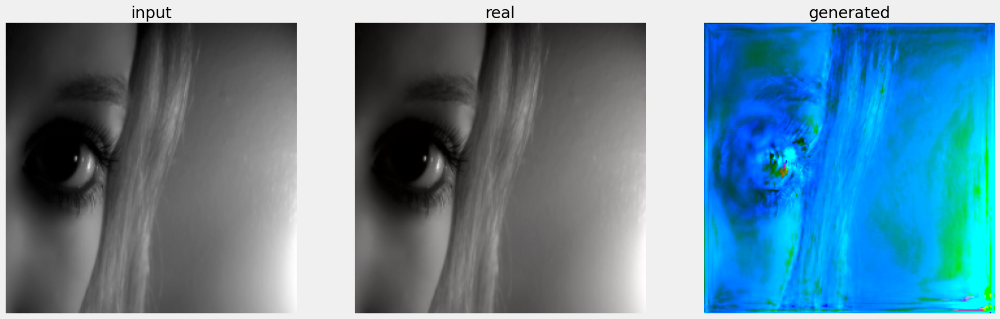

Epoch 10: Generator loss: 0.06931794530105614, Critic loss: -3.4530574506369187
Epoch: 10


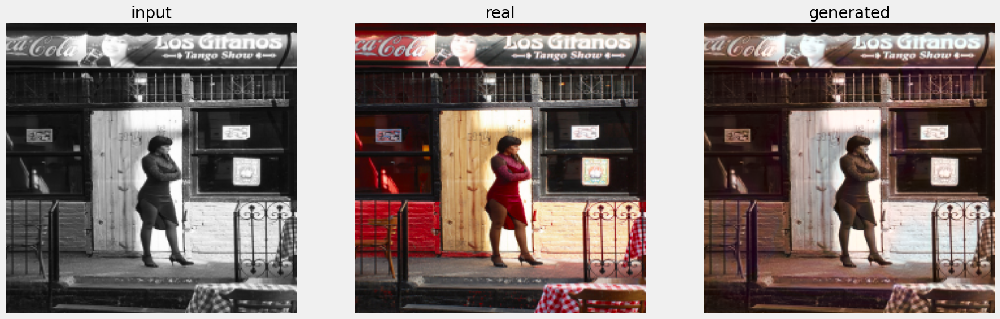

Epoch 20: Generator loss: 0.06216513088950178, Critic loss: -6.148997990788928
Epoch: 20


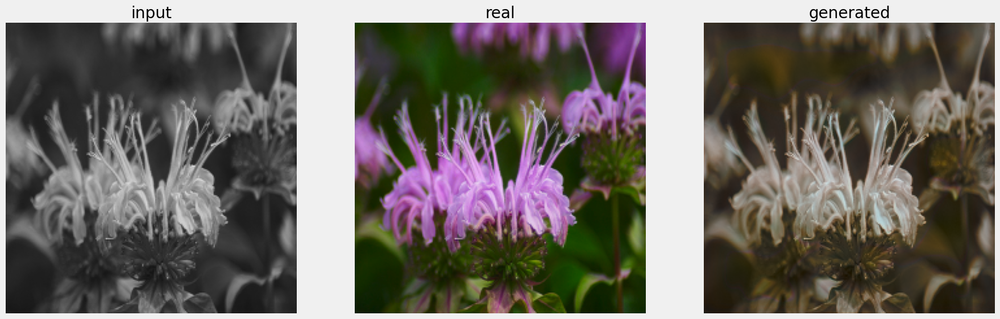

Epoch 30: Generator loss: 0.05944373302761986, Critic loss: -7.701411509187149
Epoch: 30


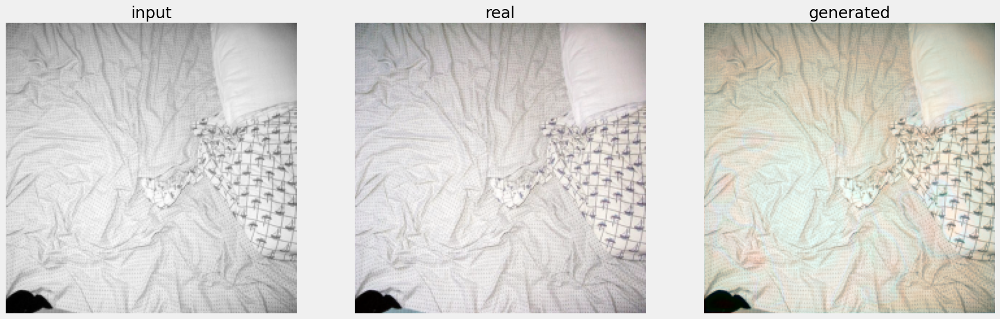

Epoch 40: Generator loss: 0.057834646480181016, Critic loss: -8.845397321974072
Epoch: 40


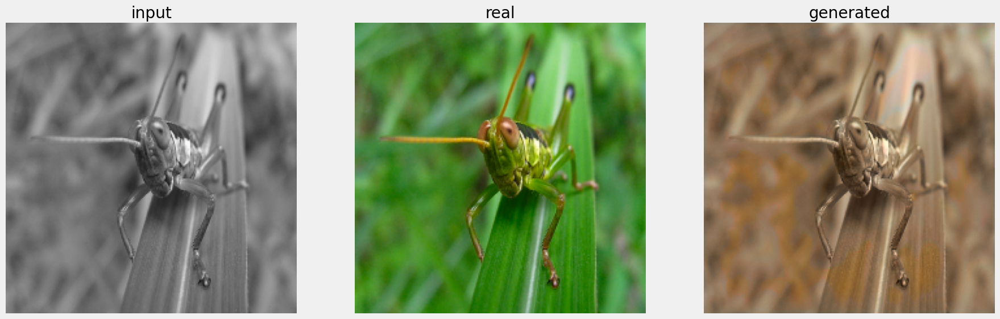

Epoch 50: Generator loss: 0.0564412221466362, Critic loss: -9.864531741994067
Epoch: 50


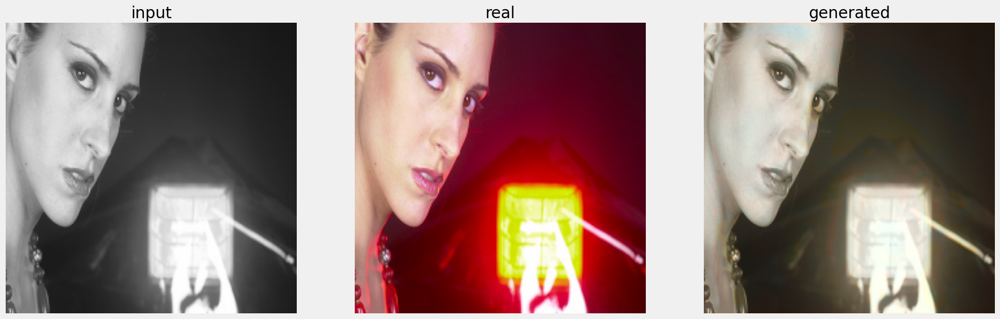

Epoch 60: Generator loss: 0.05555833208880423, Critic loss: -10.691986016048725
Epoch: 60


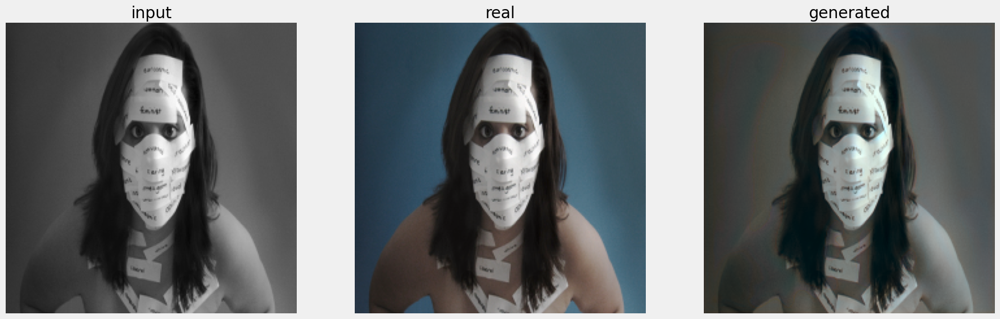

Epoch 70: Generator loss: 0.05475984253646493, Critic loss: -11.364340691280837
Epoch: 70


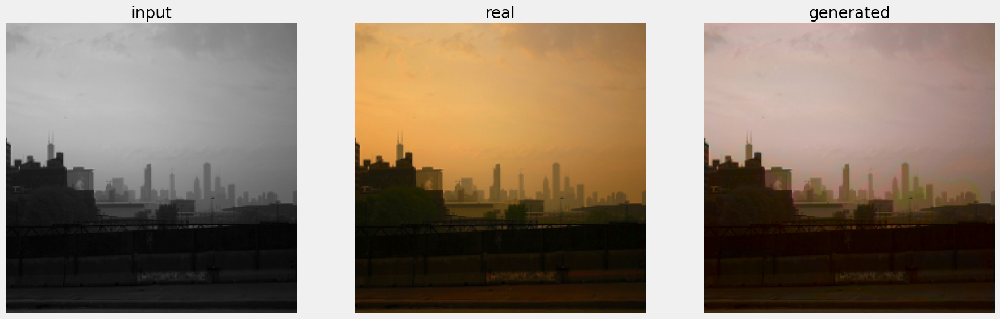

Epoch 80: Generator loss: 0.05411610472490457, Critic loss: -11.92975427597499
Epoch: 80


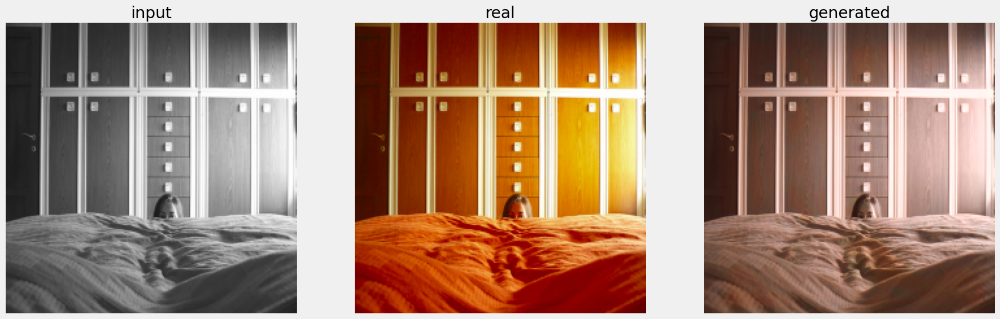

Epoch 90: Generator loss: 0.05362184223836954, Critic loss: -12.40864338496597
Epoch: 90


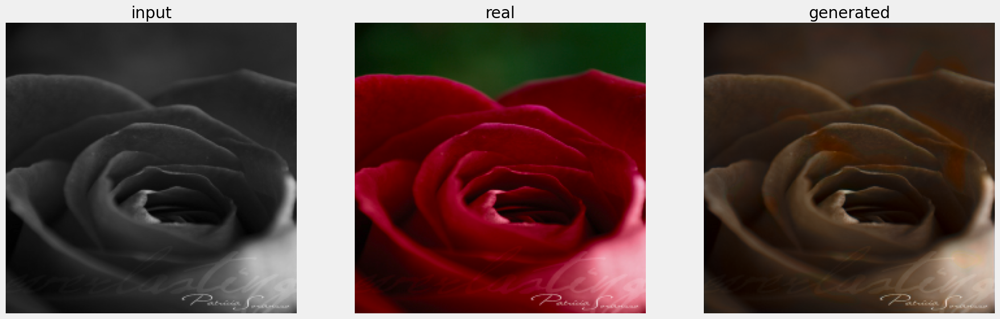

Epoch 100: Generator loss: 0.05335897266375205, Critic loss: -12.79638413565287
Epoch: 100


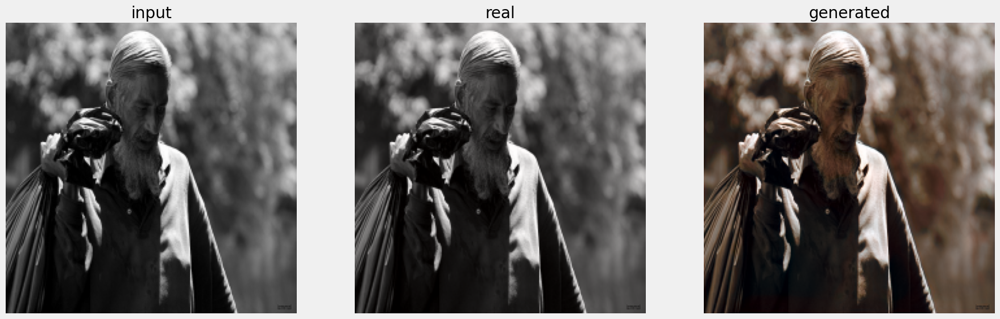

Epoch 110: Generator loss: 0.052938900726748846, Critic loss: -13.157225758887165
Epoch: 110


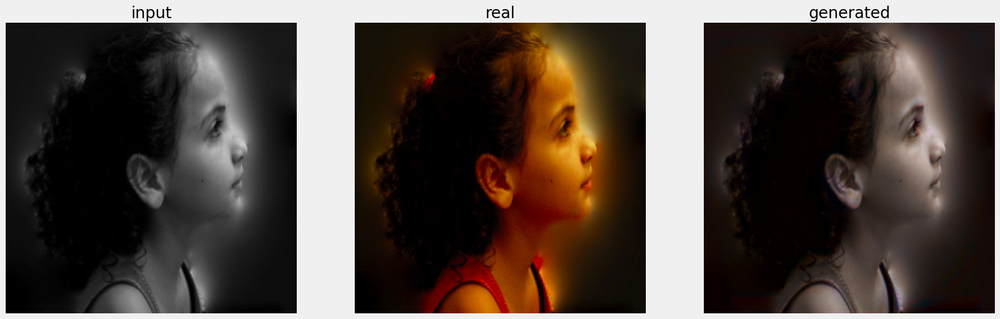

Epoch 120: Generator loss: 0.052641960765139245, Critic loss: -13.47782834196063
Epoch: 120


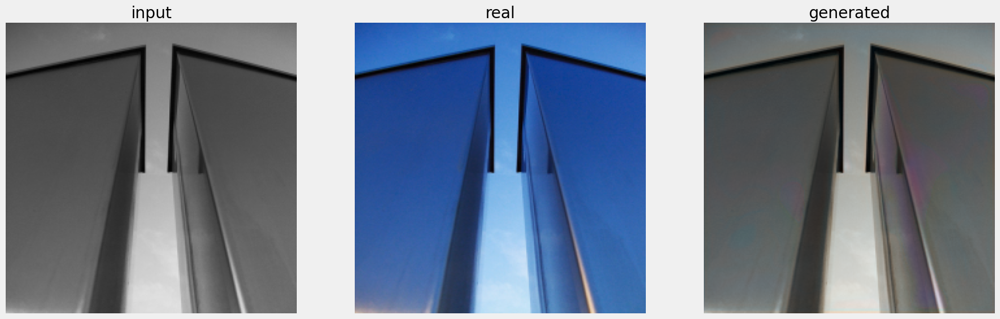

Epoch 130: Generator loss: 0.052311650284197306, Critic loss: -13.75555582513989
Epoch: 130


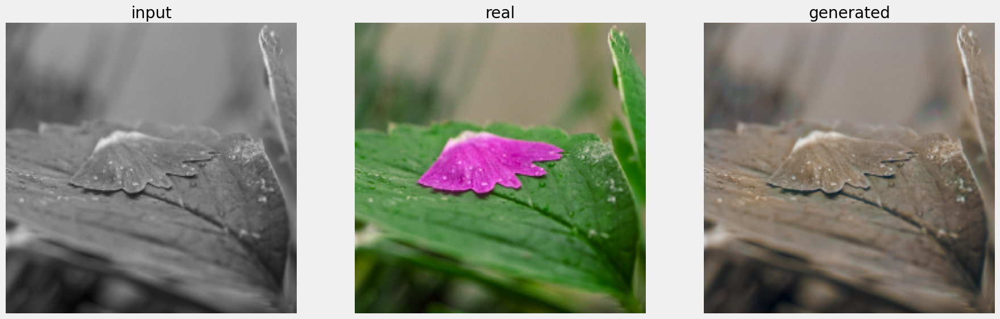

In [ ]:
trainer = pl.Trainer(max_epochs=150, accelerator='gpu', devices=-1)
trainer.fit(cwgan, train_loader)